In [29]:
###############
## Libraries ##
###############

import tensorflow as tf
import matplotlib.pyplot as plt 
import numpy as np
from tensorflow.keras import datasets, layers, models, losses
from keras.callbacks import ModelCheckpoint
from keras.models import load_model

# Training

In [30]:
# load in mnist digit data
all_data = np.load("/scratch/gpfs/eysu/src_data/mnist.npz")
print(all_data.files)
x_test = all_data['x_test']
x_train = all_data['x_train']
y_train = all_data['y_train']
y_test = all_data['y_test']

print(x_test.shape)
print(x_train.shape)
print(y_train.shape)
print(y_test.shape)


['x_test', 'x_train', 'y_train', 'y_test']
(10000, 28, 28)
(60000, 28, 28)
(60000,)
(10000,)


x_train shape: (60000, 28, 28) y_train shape: (60000,)
60000 train set
10000 test set
y = 8 8


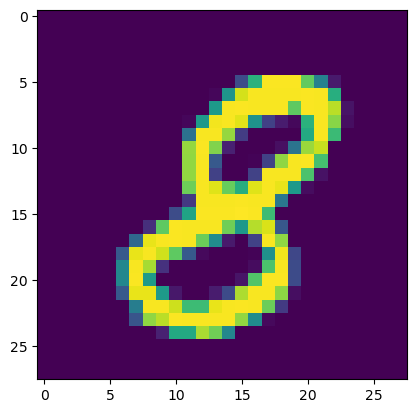

In [31]:
# Split data and reset dimensions
labels = ["0",  # index 0
          "1",  # index 1
          "2",  # index 2 
          "3",  # index 3 
          "4",  # index 4
          "5",  # index 5
          "6",  # index 6 
          "7",  # index 7 
          "8",  # index 8 
          "9"]  # index 9

# Print training set shape - note there are 60,000 training data of image size of 28x28, 60,000 train labels)
print("x_train shape:", x_train.shape, "y_train shape:", y_train.shape)

# save train labels
y_train_labels = y_train
y_test_labels = y_test

# Print the number of training and test datasets
print(x_train.shape[0], 'train set')
print(x_test.shape[0], 'test set')


x_train = x_train.astype('float32') / 255
x_test = x_test.astype('float32') / 255

# Further break training data into train / validation sets (# put 5000 into validation set and keep remaining 55,000 for train)
(x_train, x_valid) = x_train[5000:], x_train[:5000] 
(y_train, y_valid) = y_train[5000:], y_train[:5000]

# Reshape input data from (28, 28) to (28, 28, 1)
w, h = 28, 28
x_train = x_train.reshape(x_train.shape[0], w, h, 1)
x_valid = x_valid.reshape(x_valid.shape[0], w, h, 1)
x_test = x_test.reshape(x_test.shape[0], w, h, 1)

# Validation set
y_valid = tf.keras.utils.to_categorical(y_valid, 10)
y_test = tf.keras.utils.to_categorical(y_test, 10)
    
# Image index, you can pick any number between 0 and 59,999
img_index = 5
# y_train contains the lables, ranging from 0 to 9
label_index = y_train[img_index]
# Print the label, for example 2 Pullover
print ("y = " + str(label_index) + " " +(labels[label_index]))
# # Show one of the images from the training dataset
plt.imshow(x_train[img_index])
plt.show()

In [21]:
# define custom softmax function
import tensorflow.experimental.numpy as tnp

TEMP = 10
def custom_softmax(x, temp_param = TEMP):
    
    # attempt 1: 
    # output = tnp.exp(x/temp_param)/tnp.sum(tnp.exp(x/temp_param), axis=0)

    # what tf softmax activation function actually does: 
    # exp(x) / tf.reduce_sum(exp(x))
    # start from this and add in temp param

    output = tf.exp(x/temp_param) / tf.reduce_sum(tf.exp(x/temp_param), axis=0, keepdims=True)
    return output

def one_hot(x):
    print(x.shape)
    softmax_output = custom_softmax(x)
    print(softmax_output.shape)
    print(tf.print(softmax_output[0]))
    one_hot = tf.one_hot(indices=tf.argmax(softmax_output, axis=1), depth=softmax_output.shape[1])
    print(one_hot.shape)
    print(tf.print(one_hot[0]))
    return one_hot

In [22]:
################################################################
## This cell runs the serial reproduction training procedure. ##
################################################################

DATASET = '_DigitMNIST' 
REGIME = '_TRAINED_'

# Number of iterations in the serial reproduction
MAX_ITER = 25
# Number of epochs per training run
EPOCHS = 10

for iteration in range(0,MAX_ITER):
    # If iteration is seed, train on original target vectors, else, train on y_hat from time t-1
    if iteration == 0:
        # One-hot encode the labels
        y_train = tf.keras.utils.to_categorical(y_train, 10)
        mpth = 'model.weights.best.hdf5'
        y_hat_test_name = 'y_hat_test_seed'
        y_hat_train_name = 'y_hat_train_seed'      
    elif iteration > 0:
        # Key step: set new targets as y_hat
        y_train = y_hat    
        mpth = 'model.weights.best.' + 'iter' + str(iteration) + '.hdf5'
        y_hat_test_name = 'y_hat_test_' + 'iter' + str(iteration)
        y_hat_train_name = 'y_hat_train_' + 'iter' + str(iteration)

    # Define the model: a small CNN model (could probably be done outside loop)
    model = tf.keras.Sequential()

    # Must define the input shape in the first layer of the neural network
    model.add(tf.keras.layers.Conv2D(filters=64, kernel_size=2, padding='same', activation='relu', input_shape=(28,28,1))) 
    model.add(tf.keras.layers.MaxPooling2D(pool_size=2))
    model.add(tf.keras.layers.Dropout(0.3))

    model.add(tf.keras.layers.Conv2D(filters=32, kernel_size=2, padding='same', activation='relu'))
    model.add(tf.keras.layers.MaxPooling2D(pool_size=2))
    model.add(tf.keras.layers.Dropout(0.3))

    model.add(tf.keras.layers.Flatten())
    model.add(tf.keras.layers.Dense(256, activation='relu'))
    model.add(tf.keras.layers.Dropout(0.5))
    model.add(tf.keras.layers.Dense(10, activation=custom_softmax))

    # Take a look at the model summary
    # model.summary()

    # define optimization and energy parameters
    model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])
    # Save checkpoints
    checkpointer = ModelCheckpoint(filepath= '/scratch/gpfs/eysu/SM_temp_outputs/T=' + str(TEMP) + "/" + mpth, verbose = 1, save_best_only=False) #True
    # Train the model
    model.fit(x_train,
             y_train,
             batch_size=64,
             epochs=EPOCHS,
             validation_data=(x_valid, y_valid),
             callbacks=[checkpointer])

    # Load the weights with the best validation accuracy
    y_hat = model.predict(x_train) #feed back serial reproduction targets
    y_hat_test = model.predict(x_test)
    
    model.load_weights('/scratch/gpfs/eysu/SM_temp_outputs/T=' + str(TEMP) + "/" + mpth)
    # Evaluate the model on test set
    score = model.evaluate(x_test, y_test, verbose=0)
    # Print test accuracy
    print('\n', 'Test accuracy:', score[1])

    # Save results for each iteration in the serial reproduction chain
    np.save('/scratch/gpfs/eysu/SM_temp_outputs/T=' + str(TEMP) + "/" + y_hat_train_name + DATASET + REGIME + '.npy', y_train)
    print('/scratch/gpfs/eysu/SM_temp_outputs/T=' + str(TEMP) + "/" + y_hat_train_name)
#     np.save('weights/' + y_hat_test_name + DATASET + REGIME + '.npy', y_test)
    np.save('/scratch/gpfs/eysu/SM_temp_outputs/T=' + str(TEMP) + "/" + y_hat_test_name + DATASET + REGIME + '.npy', y_hat_test)
    print('/scratch/gpfs/eysu/SM_temp_outputs/T=' + str(TEMP) + "/" + y_hat_test_name)



Epoch 1/10
834/860 [============================>.] - ETA: 0s - loss: 0.5666 - accuracy: 0.8233
Epoch 1: saving model to /scratch/gpfs/eysu/SM_temp_outputs/T=10/model.weights.best.hdf5
860/860 [==============================] - 2s 2ms/step - loss: 0.5584 - accuracy: 0.8259 - val_loss: 0.1644 - val_accuracy: 0.9566
Epoch 2/10
860/860 [==============================] - ETA: 0s - loss: 0.2355 - accuracy: 0.9266
Epoch 2: saving model to /scratch/gpfs/eysu/SM_temp_outputs/T=10/model.weights.best.hdf5
860/860 [==============================] - 2s 2ms/step - loss: 0.2355 - accuracy: 0.9266 - val_loss: 0.1009 - val_accuracy: 0.9710
Epoch 3/10
860/860 [==============================] - ETA: 0s - loss: 0.1660 - accuracy: 0.9485
Epoch 3: saving model to /scratch/gpfs/eysu/SM_temp_outputs/T=10/model.weights.best.hdf5
860/860 [==============================] - 2s 2ms/step - loss: 0.1660 - accuracy: 0.9485 - val_loss: 0.0766 - val_accuracy: 0.9774
Epoch 4/10
858/860 [============================>.] 

Epoch 6/10
833/860 [============================>.] - ETA: 0s - loss: 0.0748 - accuracy: 0.9505
Epoch 6: saving model to /scratch/gpfs/eysu/SM_temp_outputs/T=10/model.weights.best.iter2.hdf5
860/860 [==============================] - 2s 2ms/step - loss: 0.0747 - accuracy: 0.9505 - val_loss: 0.1057 - val_accuracy: 0.9696
Epoch 7/10
837/860 [============================>.] - ETA: 0s - loss: 0.0723 - accuracy: 0.9526
Epoch 7: saving model to /scratch/gpfs/eysu/SM_temp_outputs/T=10/model.weights.best.iter2.hdf5
860/860 [==============================] - 2s 2ms/step - loss: 0.0724 - accuracy: 0.9524 - val_loss: 0.1054 - val_accuracy: 0.9712
Epoch 8/10
838/860 [============================>.] - ETA: 0s - loss: 0.0704 - accuracy: 0.9529
Epoch 8: saving model to /scratch/gpfs/eysu/SM_temp_outputs/T=10/model.weights.best.iter2.hdf5
860/860 [==============================] - 2s 2ms/step - loss: 0.0706 - accuracy: 0.9527 - val_loss: 0.1014 - val_accuracy: 0.9758
Epoch 9/10
832/860 [==============

860/860 [==============================] - 2s 2ms/step - loss: 0.1176 - accuracy: 0.9525 - val_loss: 0.1406 - val_accuracy: 0.9658

 Test accuracy: 0.9580000042915344
/scratch/gpfs/eysu/SM_temp_outputs/T=10/y_hat_train_iter4
/scratch/gpfs/eysu/SM_temp_outputs/T=10/y_hat_test_iter4
Epoch 1/10
839/860 [============================>.] - ETA: 0s - loss: 0.2463 - accuracy: 0.8150
Epoch 1: saving model to /scratch/gpfs/eysu/SM_temp_outputs/T=10/model.weights.best.iter5.hdf5
860/860 [==============================] - 2s 2ms/step - loss: 0.2446 - accuracy: 0.8168 - val_loss: 0.2399 - val_accuracy: 0.9396
Epoch 2/10
857/860 [============================>.] - ETA: 0s - loss: 0.1684 - accuracy: 0.9090
Epoch 2: saving model to /scratch/gpfs/eysu/SM_temp_outputs/T=10/model.weights.best.iter5.hdf5
860/860 [==============================] - 2s 2ms/step - loss: 0.1685 - accuracy: 0.9090 - val_loss: 0.2084 - val_accuracy: 0.9536
Epoch 3/10
833/860 [============================>.] - ETA: 0s - loss: 0.15

Epoch 5/10
854/860 [============================>.] - ETA: 0s - loss: 0.1984 - accuracy: 0.9385
Epoch 5: saving model to /scratch/gpfs/eysu/SM_temp_outputs/T=10/model.weights.best.iter7.hdf5
860/860 [==============================] - 2s 2ms/step - loss: 0.1983 - accuracy: 0.9384 - val_loss: 0.2192 - val_accuracy: 0.9588
Epoch 6/10
846/860 [============================>.] - ETA: 0s - loss: 0.1966 - accuracy: 0.9391
Epoch 6: saving model to /scratch/gpfs/eysu/SM_temp_outputs/T=10/model.weights.best.iter7.hdf5
860/860 [==============================] - 2s 2ms/step - loss: 0.1966 - accuracy: 0.9389 - val_loss: 0.2060 - val_accuracy: 0.9610
Epoch 7/10
854/860 [============================>.] - ETA: 0s - loss: 0.1949 - accuracy: 0.9393
Epoch 7: saving model to /scratch/gpfs/eysu/SM_temp_outputs/T=10/model.weights.best.iter7.hdf5
860/860 [==============================] - 2s 2ms/step - loss: 0.1949 - accuracy: 0.9393 - val_loss: 0.2114 - val_accuracy: 0.9582
Epoch 8/10
848/860 [==============

860/860 [==============================] - 2s 2ms/step - loss: 0.2647 - accuracy: 0.9329 - val_loss: 0.2784 - val_accuracy: 0.9534
Epoch 10/10
842/860 [============================>.] - ETA: 0s - loss: 0.2644 - accuracy: 0.9321
Epoch 10: saving model to /scratch/gpfs/eysu/SM_temp_outputs/T=10/model.weights.best.iter9.hdf5
860/860 [==============================] - 2s 2ms/step - loss: 0.2644 - accuracy: 0.9320 - val_loss: 0.2740 - val_accuracy: 0.9544

 Test accuracy: 0.9401000142097473
/scratch/gpfs/eysu/SM_temp_outputs/T=10/y_hat_train_iter9
/scratch/gpfs/eysu/SM_temp_outputs/T=10/y_hat_test_iter9
Epoch 1/10
843/860 [============================>.] - ETA: 0s - loss: 0.3822 - accuracy: 0.8207
Epoch 1: saving model to /scratch/gpfs/eysu/SM_temp_outputs/T=10/model.weights.best.iter10.hdf5
860/860 [==============================] - 2s 2ms/step - loss: 0.3813 - accuracy: 0.8219 - val_loss: 0.4091 - val_accuracy: 0.9346
Epoch 2/10
860/860 [==============================] - ETA: 0s - loss: 0

860/860 [==============================] - 2s 2ms/step - loss: 0.3960 - accuracy: 0.9000 - val_loss: 0.4053 - val_accuracy: 0.9340
Epoch 4/10
836/860 [============================>.] - ETA: 0s - loss: 0.3914 - accuracy: 0.9061
Epoch 4: saving model to /scratch/gpfs/eysu/SM_temp_outputs/T=10/model.weights.best.iter12.hdf5
860/860 [==============================] - 2s 2ms/step - loss: 0.3916 - accuracy: 0.9063 - val_loss: 0.4027 - val_accuracy: 0.9360
Epoch 5/10
841/860 [============================>.] - ETA: 0s - loss: 0.3892 - accuracy: 0.9097
Epoch 5: saving model to /scratch/gpfs/eysu/SM_temp_outputs/T=10/model.weights.best.iter12.hdf5
860/860 [==============================] - 2s 2ms/step - loss: 0.3887 - accuracy: 0.9098 - val_loss: 0.3980 - val_accuracy: 0.9394
Epoch 6/10
842/860 [============================>.] - ETA: 0s - loss: 0.3873 - accuracy: 0.9129
Epoch 6: saving model to /scratch/gpfs/eysu/SM_temp_outputs/T=10/model.weights.best.iter12.hdf5
860/860 [======================

Epoch 8/10
852/860 [============================>.] - ETA: 0s - loss: 0.4614 - accuracy: 0.9068
Epoch 8: saving model to /scratch/gpfs/eysu/SM_temp_outputs/T=10/model.weights.best.iter14.hdf5
860/860 [==============================] - 2s 2ms/step - loss: 0.4614 - accuracy: 0.9068 - val_loss: 0.4735 - val_accuracy: 0.9246
Epoch 9/10
850/860 [============================>.] - ETA: 0s - loss: 0.4614 - accuracy: 0.9065
Epoch 9: saving model to /scratch/gpfs/eysu/SM_temp_outputs/T=10/model.weights.best.iter14.hdf5
860/860 [==============================] - 2s 2ms/step - loss: 0.4611 - accuracy: 0.9065 - val_loss: 0.4642 - val_accuracy: 0.9266
Epoch 10/10
855/860 [============================>.] - ETA: 0s - loss: 0.4607 - accuracy: 0.9067
Epoch 10: saving model to /scratch/gpfs/eysu/SM_temp_outputs/T=10/model.weights.best.iter14.hdf5
860/860 [==============================] - 2s 2ms/step - loss: 0.4605 - accuracy: 0.9068 - val_loss: 0.4601 - val_accuracy: 0.9248

 Test accuracy: 0.9075999855

Epoch 2/10
839/860 [============================>.] - ETA: 0s - loss: 0.6051 - accuracy: 0.8363
Epoch 2: saving model to /scratch/gpfs/eysu/SM_temp_outputs/T=10/model.weights.best.iter17.hdf5
860/860 [==============================] - 2s 2ms/step - loss: 0.6060 - accuracy: 0.8370 - val_loss: 0.7563 - val_accuracy: 0.8952
Epoch 3/10
840/860 [============================>.] - ETA: 0s - loss: 0.5979 - accuracy: 0.8598
Epoch 3: saving model to /scratch/gpfs/eysu/SM_temp_outputs/T=10/model.weights.best.iter17.hdf5
860/860 [==============================] - 2s 2ms/step - loss: 0.5984 - accuracy: 0.8597 - val_loss: 0.6575 - val_accuracy: 0.8968
Epoch 4/10
841/860 [============================>.] - ETA: 0s - loss: 0.5966 - accuracy: 0.8743
Epoch 4: saving model to /scratch/gpfs/eysu/SM_temp_outputs/T=10/model.weights.best.iter17.hdf5
860/860 [==============================] - 2s 2ms/step - loss: 0.5954 - accuracy: 0.8745 - val_loss: 0.6507 - val_accuracy: 0.8984
Epoch 5/10
839/860 [===========

860/860 [==============================] - 2s 2ms/step - loss: 0.6788 - accuracy: 0.8681 - val_loss: 0.8607 - val_accuracy: 0.8786
Epoch 7/10
838/860 [============================>.] - ETA: 0s - loss: 0.6769 - accuracy: 0.8725
Epoch 7: saving model to /scratch/gpfs/eysu/SM_temp_outputs/T=10/model.weights.best.iter19.hdf5
860/860 [==============================] - 2s 2ms/step - loss: 0.6784 - accuracy: 0.8725 - val_loss: 0.8635 - val_accuracy: 0.8766
Epoch 8/10
840/860 [============================>.] - ETA: 0s - loss: 0.6794 - accuracy: 0.8775
Epoch 8: saving model to /scratch/gpfs/eysu/SM_temp_outputs/T=10/model.weights.best.iter19.hdf5
860/860 [==============================] - 2s 2ms/step - loss: 0.6782 - accuracy: 0.8772 - val_loss: 0.8297 - val_accuracy: 0.8862
Epoch 9/10
839/860 [============================>.] - ETA: 0s - loss: 0.6766 - accuracy: 0.8783
Epoch 9: saving model to /scratch/gpfs/eysu/SM_temp_outputs/T=10/model.weights.best.iter19.hdf5
860/860 [======================


 Test accuracy: 0.8065999746322632
/scratch/gpfs/eysu/SM_temp_outputs/T=10/y_hat_train_iter21
/scratch/gpfs/eysu/SM_temp_outputs/T=10/y_hat_test_iter21
Epoch 1/10
856/860 [============================>.] - ETA: 0s - loss: 0.7131 - accuracy: 0.6806
Epoch 1: saving model to /scratch/gpfs/eysu/SM_temp_outputs/T=10/model.weights.best.iter22.hdf5
860/860 [==============================] - 2s 2ms/step - loss: 0.7131 - accuracy: 0.6808 - val_loss: 1.6344 - val_accuracy: 0.8066
Epoch 2/10
855/860 [============================>.] - ETA: 0s - loss: 0.7096 - accuracy: 0.7605
Epoch 2: saving model to /scratch/gpfs/eysu/SM_temp_outputs/T=10/model.weights.best.iter22.hdf5
860/860 [==============================] - 2s 2ms/step - loss: 0.7107 - accuracy: 0.7602 - val_loss: 1.6375 - val_accuracy: 0.7690
Epoch 3/10
833/860 [============================>.] - ETA: 0s - loss: 0.7126 - accuracy: 0.7680
Epoch 3: saving model to /scratch/gpfs/eysu/SM_temp_outputs/T=10/model.weights.best.iter22.hdf5
860/860 [

Epoch 5/10
836/860 [============================>.] - ETA: 0s - loss: 0.7132 - accuracy: 0.7572
Epoch 5: saving model to /scratch/gpfs/eysu/SM_temp_outputs/T=10/model.weights.best.iter24.hdf5
860/860 [==============================] - 2s 2ms/step - loss: 0.7123 - accuracy: 0.7575 - val_loss: 1.4766 - val_accuracy: 0.7032
Epoch 6/10
859/860 [============================>.] - ETA: 0s - loss: 0.7121 - accuracy: 0.7629
Epoch 6: saving model to /scratch/gpfs/eysu/SM_temp_outputs/T=10/model.weights.best.iter24.hdf5
860/860 [==============================] - 2s 2ms/step - loss: 0.7120 - accuracy: 0.7629 - val_loss: 1.4771 - val_accuracy: 0.6990
Epoch 7/10
834/860 [============================>.] - ETA: 0s - loss: 0.7140 - accuracy: 0.7664
Epoch 7: saving model to /scratch/gpfs/eysu/SM_temp_outputs/T=10/model.weights.best.iter24.hdf5
860/860 [==============================] - 2s 2ms/step - loss: 0.7117 - accuracy: 0.7664 - val_loss: 1.4239 - val_accuracy: 0.6882
Epoch 8/10
856/860 [===========

# Visualize

In [32]:
###########################################################################################
## Read prediction softmax layer activations for all test set images, and all iterations ##
###########################################################################################

TEMP = 1
MAX_ITER = 25

# Build arrays of dimensions: N training images X L labels X P iterations

y_hat_train_arr = np.zeros([y_train.shape[0], len(labels), MAX_ITER])
y_hat_test_arr = np.zeros([y_test.shape[0], len(labels), MAX_ITER])

for i in range(MAX_ITER):
    if i == 0:
        y_hat_train_name = 'y_hat_train_seed'
        y_hat_test_name = 'y_hat_test_seed'
    
    else:
        y_hat_train_name = 'y_hat_train_' + 'iter' + str(i)
        y_hat_test_name = 'y_hat_test_' + 'iter' + str(i)
        
    # Load test set softmax outputs 
    yhtr = np.load('/scratch/gpfs/eysu/SM_temp_outputs/T=' + str(TEMP) + "/" + y_hat_train_name + DATASET + REGIME + '.npy')
    yhte = np.load('/scratch/gpfs/eysu/SM_temp_outputs/T=' + str(TEMP) + "/" + y_hat_test_name + DATASET + REGIME + '.npy')  

    # The first time through, use binary weight vectors to save correct class array
    if i == 0:
        true_class_tr = np.nonzero(yhtr)[1]
        true_class_te = np.nonzero(yhte)[1]
        
    y_hat_train_arr[:, :, i] = yhtr
    y_hat_test_arr[:, :, i] = yhte


print(y_hat_train_arr.shape)
# (55000, 50, 10)
print(y_hat_test_arr.shape)
# (10000, 50, 10)


(55000, 10, 25)
(10000, 10, 25)


In [33]:
# Repeat for all Temps. Manually for now

###########################################################################################
## Read prediction softmax layer activations for all test set images, and all iterations ##
###########################################################################################

TEMP = 0.1
MAX_ITER = 25

# Build arrays of dimensions: N training images X L labels X P iterations

y_hat_train_arr_01 = np.zeros([y_train.shape[0], len(labels), MAX_ITER])
y_hat_test_arr_01 = np.zeros([y_test.shape[0], len(labels), MAX_ITER])

for i in range(MAX_ITER):
    if i == 0:
        y_hat_train_name = 'y_hat_train_seed'
        y_hat_test_name = 'y_hat_test_seed'
    
    else:
        y_hat_train_name = 'y_hat_train_' + 'iter' + str(i)
        y_hat_test_name = 'y_hat_test_' + 'iter' + str(i)
        
    # Load test set softmax outputs 
    yhtr = np.load('/scratch/gpfs/eysu/SM_temp_outputs/T=' + str(TEMP) + "/" + y_hat_train_name + DATASET + REGIME + '.npy')
    yhte = np.load('/scratch/gpfs/eysu/SM_temp_outputs/T=' + str(TEMP) + "/" + y_hat_test_name + DATASET + REGIME + '.npy')  

    # The first time through, use binary weight vectors to save correct class array
    if i == 0:
        true_class_tr_01 = np.nonzero(yhtr)[1]
        true_class_te_01 = np.nonzero(yhte)[1]
        
    y_hat_train_arr_01[:, :, i] = yhtr
    y_hat_test_arr_01[:, :, i] = yhte


print(y_hat_train_arr_01.shape)
# (55000, 50, 10)
print(y_hat_test_arr_01.shape)
# (10000, 50, 10)

###########################################################################################
## Read prediction softmax layer activations for all test set images, and all iterations ##
###########################################################################################

TEMP = 0.5
MAX_ITER = 25

# Build arrays of dimensions: N training images X L labels X P iterations

y_hat_train_arr_05 = np.zeros([y_train.shape[0], len(labels), MAX_ITER])
y_hat_test_arr_05 = np.zeros([y_test.shape[0], len(labels), MAX_ITER])

for i in range(MAX_ITER):
    if i == 0:
        y_hat_train_name = 'y_hat_train_seed'
        y_hat_test_name = 'y_hat_test_seed'
    
    else:
        y_hat_train_name = 'y_hat_train_' + 'iter' + str(i)
        y_hat_test_name = 'y_hat_test_' + 'iter' + str(i)
        
    # Load test set softmax outputs 
    yhtr = np.load('/scratch/gpfs/eysu/SM_temp_outputs/T=' + str(TEMP) + "/" + y_hat_train_name + DATASET + REGIME + '.npy')
    yhte = np.load('/scratch/gpfs/eysu/SM_temp_outputs/T=' + str(TEMP) + "/" + y_hat_test_name + DATASET + REGIME + '.npy')  

    # The first time through, use binary weight vectors to save correct class array
    if i == 0:
        true_class_tr_05 = np.nonzero(yhtr)[1]
        true_class_te_05 = np.nonzero(yhte)[1]
        
    y_hat_train_arr_05[:, :, i] = yhtr
    y_hat_test_arr_05[:, :, i] = yhte


print(y_hat_train_arr_05.shape)
# (55000, 50, 10)
print(y_hat_test_arr_05.shape)
# (10000, 50, 10)

###########################################################################################
## Read prediction softmax layer activations for all test set images, and all iterations ##
###########################################################################################

TEMP = 10
MAX_ITER = 25

# Build arrays of dimensions: N training images X L labels X P iterations

y_hat_train_arr_10 = np.zeros([y_train.shape[0], len(labels), MAX_ITER])
y_hat_test_arr_10 = np.zeros([y_test.shape[0], len(labels), MAX_ITER])

for i in range(MAX_ITER):
    if i == 0:
        y_hat_train_name = 'y_hat_train_seed'
        y_hat_test_name = 'y_hat_test_seed'
    
    else:
        y_hat_train_name = 'y_hat_train_' + 'iter' + str(i)
        y_hat_test_name = 'y_hat_test_' + 'iter' + str(i)
        
    # Load test set softmax outputs 
    yhtr = np.load('/scratch/gpfs/eysu/SM_temp_outputs/T=' + str(TEMP) + "/" + y_hat_train_name + DATASET + REGIME + '.npy')
    yhte = np.load('/scratch/gpfs/eysu/SM_temp_outputs/T=' + str(TEMP) + "/" + y_hat_test_name + DATASET + REGIME + '.npy')  

    # The first time through, use binary weight vectors to save correct class array
    if i == 0:
        true_class_tr_10 = np.nonzero(yhtr)[1]
        true_class_te_10 = np.nonzero(yhte)[1]
        
    y_hat_train_arr_10[:, :, i] = yhtr
    y_hat_test_arr_10[:, :, i] = yhte


print(y_hat_train_arr_10.shape)
# (55000, 50, 10)
print(y_hat_test_arr_10.shape)
# (10000, 50, 10)

(55000, 10, 25)
(10000, 10, 25)
(55000, 10, 25)
(10000, 10, 25)
(55000, 10, 25)
(10000, 10, 25)


In [44]:
# print out softmax matrices for each of temperatures
from mpl_toolkits.axes_grid1 import make_axes_locatable
import warnings
warnings.filterwarnings('ignore')
import matplotlib.backends.backend_pdf

def compare_temps(CLASS, NUM_IMAGES, data1, data2, data3, data4, rank):
    pdf = matplotlib.backends.backend_pdf.PdfPages("Serial-Reproductions-CNN-Research/vary_SM_temp_outputs/least_confusing_" + str(labels[CLASS]) + "s.pdf")
    # NUM_IMAGES softmax outputs least and most confusing images for CLASS
    # using ranking of normal images so all indices should align
    # Normal, Temp = 1
    least_confusing1 = data1[rank[:NUM_IMAGES]]
    most_confusing1 = data1[rank[-NUM_IMAGES:]]
    
    # Temp = 0.1
    least_confusing2 = data2[rank[:NUM_IMAGES]]
    most_confusing2 = data2[rank[-NUM_IMAGES:]]
 
    # Temp = 0.5
    least_confusing3 = data3[rank[:NUM_IMAGES]]
    most_confusing3 = data3[rank[-NUM_IMAGES:]]

    # Temp = 10
    least_confusing4 = data4[rank[:NUM_IMAGES]]
    most_confusing4 = data4[rank[-NUM_IMAGES:]]

    # extract NUM_IMAGES images of CLASS data from the overall training images
    class_images = x_train[np.where(true_class_tr == CLASS)]
    images_least_confusing = class_images[rank[:NUM_IMAGES]]
    images_most_confusing = class_images[rank[-NUM_IMAGES:]]

    # visualize each image
    print(str(NUM_IMAGES) + " least confusing " + str(labels[CLASS]) + "s")
    for i in range(NUM_IMAGES):
        figure = plt.figure(figsize=(50, 50))
        # plot image
        ax1 = figure.add_subplot(8, 8, 1, xticks=[], yticks=[])
        im1 = ax1.imshow(images_least_confusing[i])
        ax1.set_title("Image")

        # plot weights graph
        ax2 = figure.add_subplot(6, 6, 2)
        im2 = ax2.imshow(least_confusing2[i].T, cmap='Wistia')

        divider = make_axes_locatable(ax2)
        cax = divider.append_axes('right', size='5%', pad=0.05)
        cbar = figure.colorbar(im2, cax=cax, orientation='vertical', ticks=[0, 1])
        cbar.ax.set_yticklabels(['0', '1'])

        ax2.set(xlabel='Classes', ylabel='Iterations', title='Softmax Outputs, T=0.1')
        ax2.set_xticks(ticks=[0, 1, 2, 3, 4, 5, 6, 7, 8, 9])
        ax2.set_xticklabels(labels)
        
        # plot weights graph
        ax3 = figure.add_subplot(6, 6, 3)
        im3 = ax3.imshow(least_confusing3[i].T, cmap='Wistia')

        divider = make_axes_locatable(ax3)
        cax = divider.append_axes('right', size='5%', pad=0.05)
        cbar = figure.colorbar(im3, cax=cax, orientation='vertical', ticks=[0, 1])
        cbar.ax.set_yticklabels(['0', '1'])

        ax3.set(xlabel='Classes', ylabel='Iterations', title='Softmax Outputs, T=0.5')
        ax3.set_xticks(ticks=[0, 1, 2, 3, 4, 5, 6, 7, 8, 9])
        ax3.set_xticklabels(labels)
        
        # plot weights graph
        ax4 = figure.add_subplot(6, 6, 4)
        im4 = ax4.imshow(least_confusing1[i].T, cmap='Wistia')

        divider = make_axes_locatable(ax4)
        cax = divider.append_axes('right', size='5%', pad=0.05)
        cbar = figure.colorbar(im4, cax=cax, orientation='vertical', ticks=[0, 1])
        cbar.ax.set_yticklabels(['0', '1'])

        ax4.set(xlabel='Classes', ylabel='Iterations', title='Softmax Outputs, T=1')
        ax4.set_xticks(ticks=[0, 1, 2, 3, 4, 5, 6, 7, 8, 9])
        ax4.set_xticklabels(labels)
        
        # plot weights graph
        ax5 = figure.add_subplot(6, 6, 5)
        im5 = ax5.imshow(least_confusing4[i].T, cmap='Wistia')

        divider = make_axes_locatable(ax5)
        cax = divider.append_axes('right', size='5%', pad=0.05)
        cbar = figure.colorbar(im5, cax=cax, orientation='vertical', ticks=[0, 1])
        cbar.ax.set_yticklabels(['0', '1'])

        ax5.set(xlabel='Classes', ylabel='Iterations', title='Softmax Outputs, T=10')
        ax5.set_xticks(ticks=[0, 1, 2, 3, 4, 5, 6, 7, 8, 9])
        ax5.set_xticklabels(labels)
        
        pdf.savefig(figure, bbox_inches='tight')
        plt.show()
        
    pdf.close()
    
    

Rank method: Binary seed vector difference
50 least confusing 0s


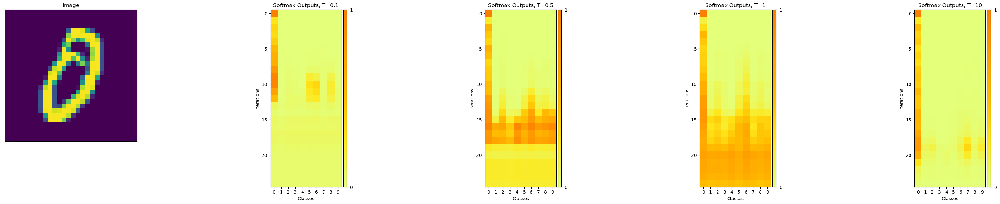

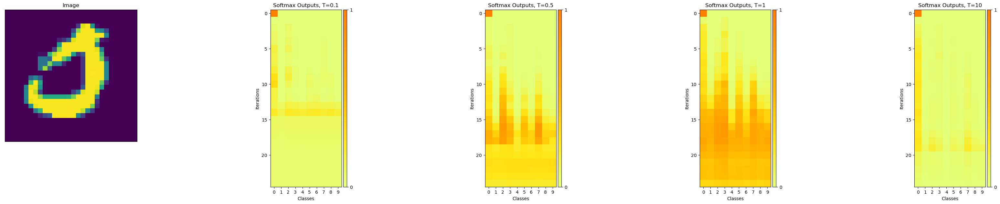

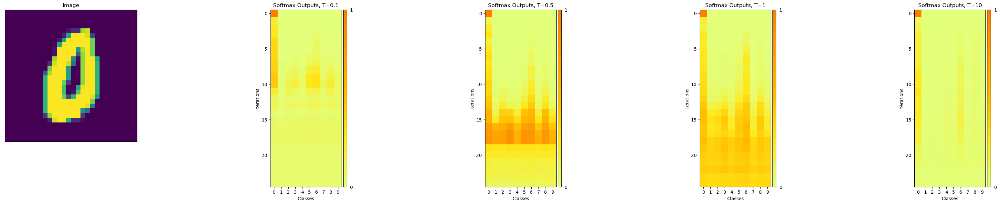

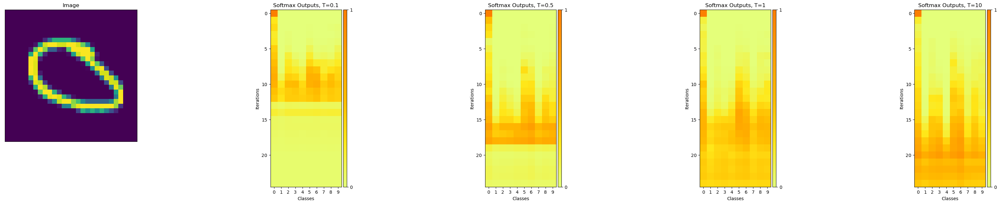

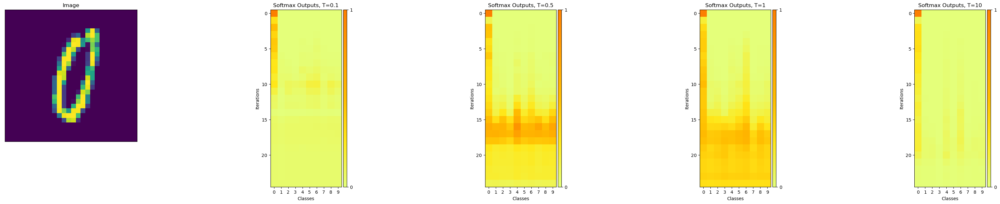

...

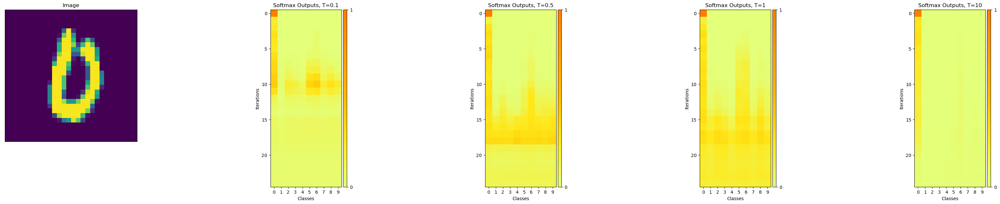

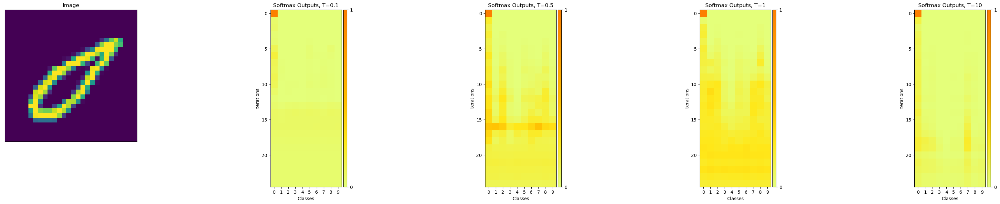

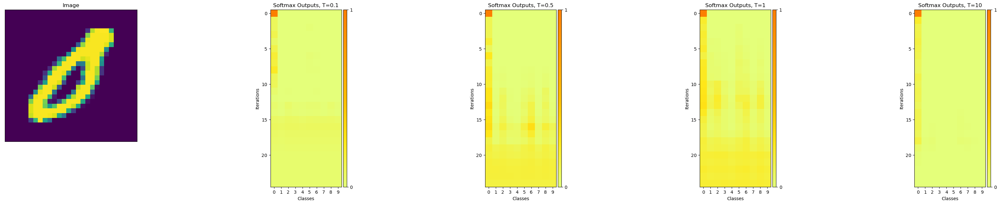

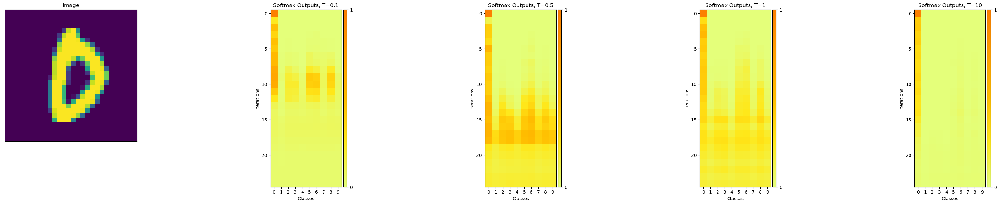

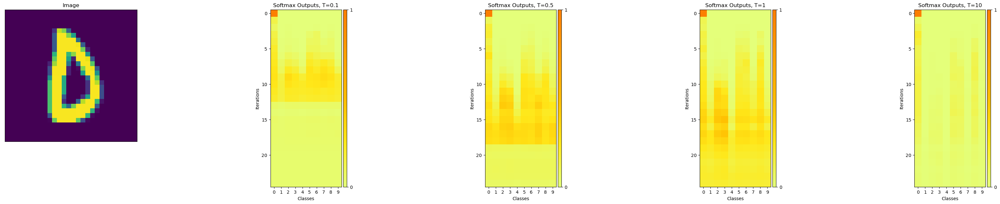

50 least confusing 1s


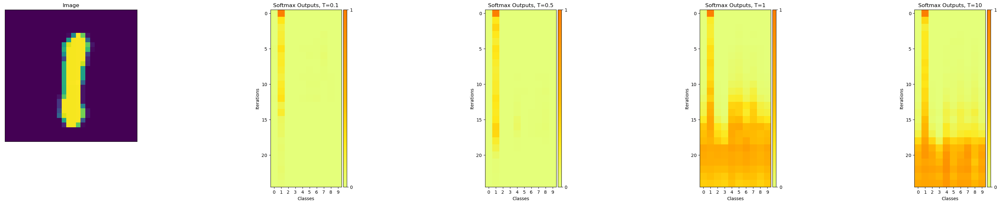

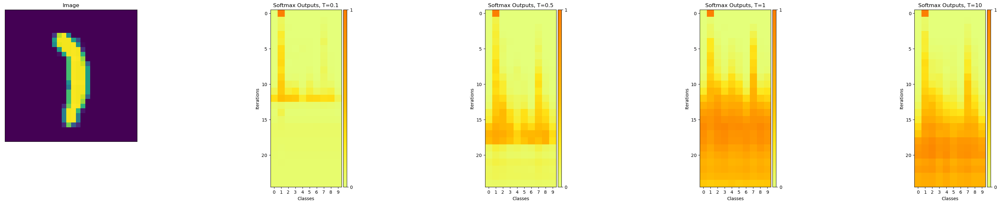

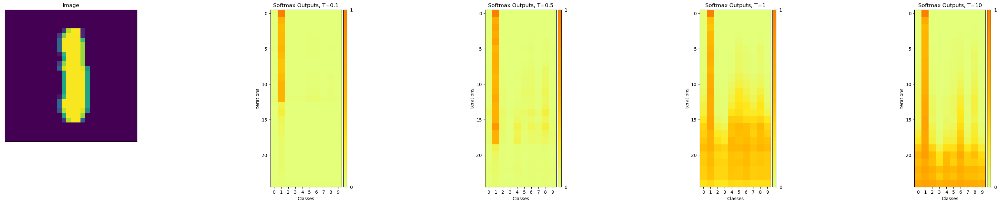

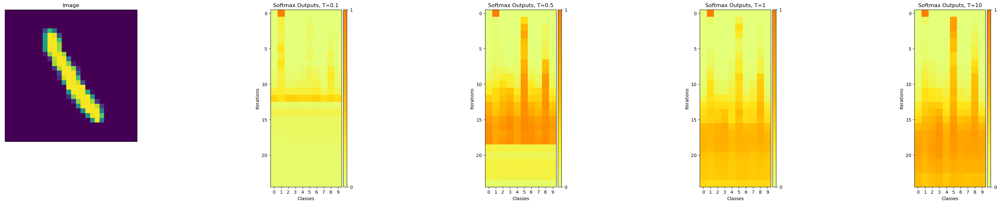

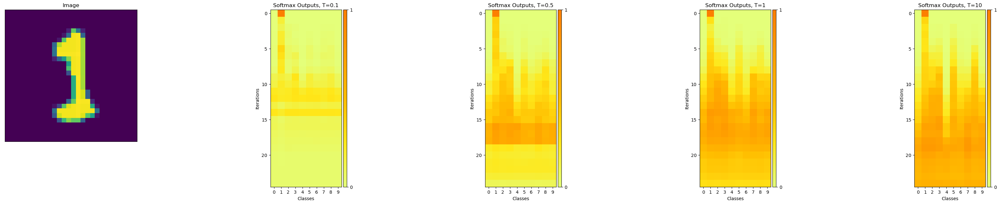

...

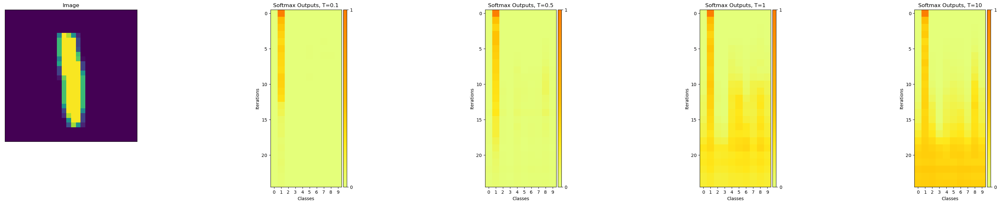

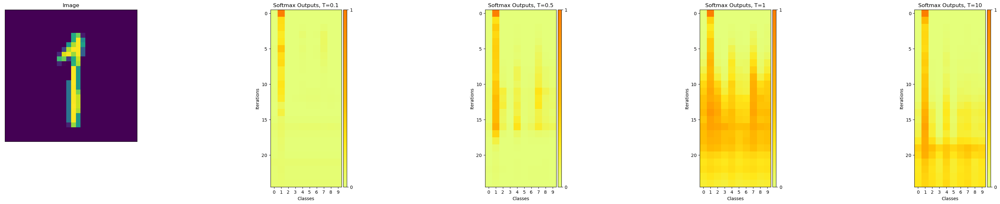

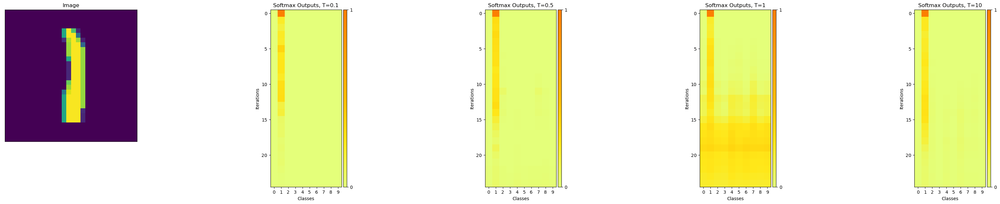

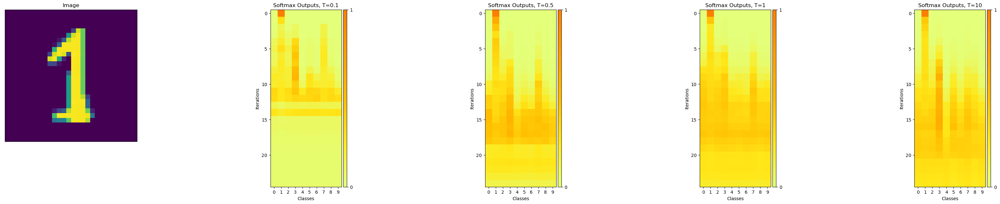

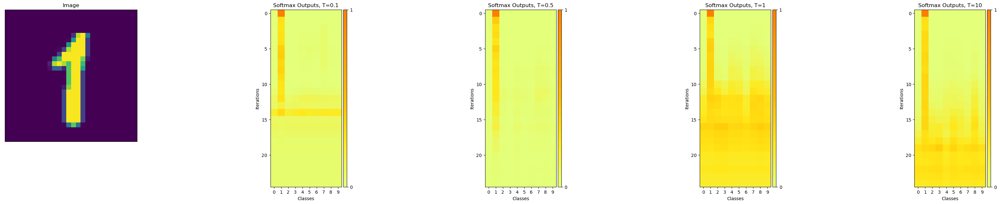

50 least confusing 2s


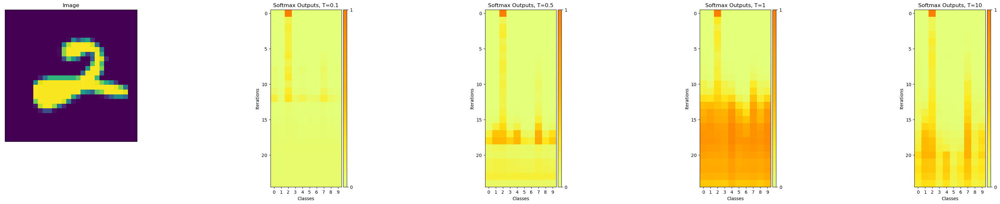

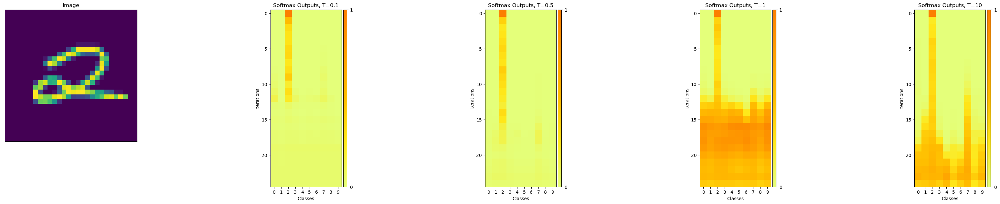

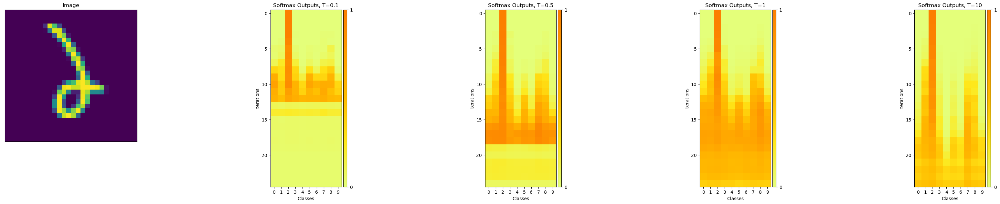

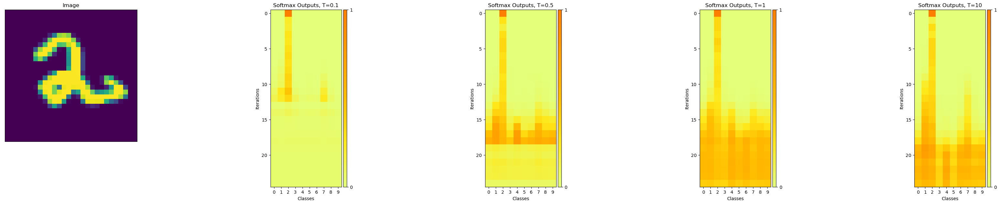

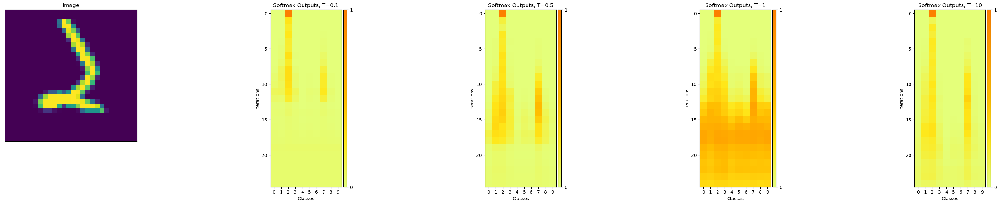

...

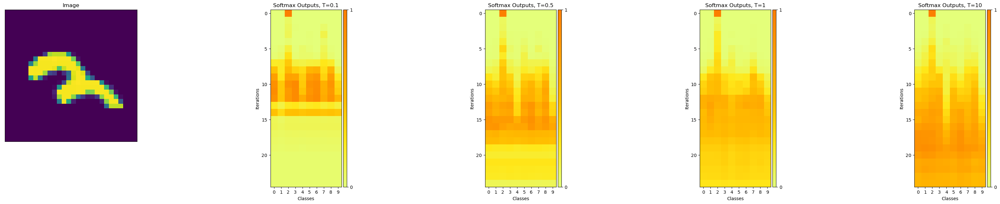

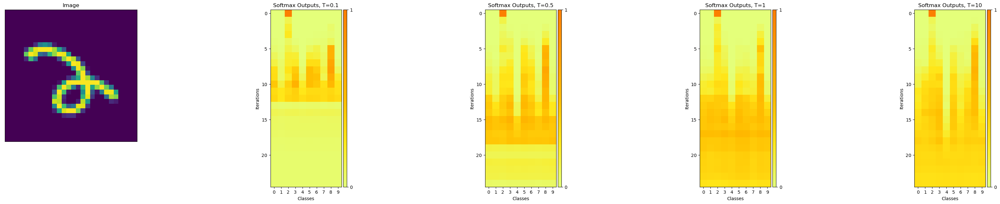

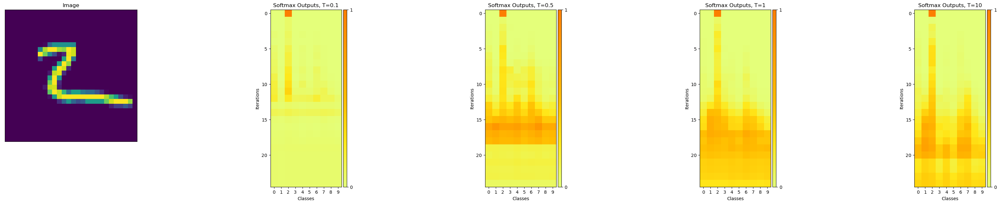

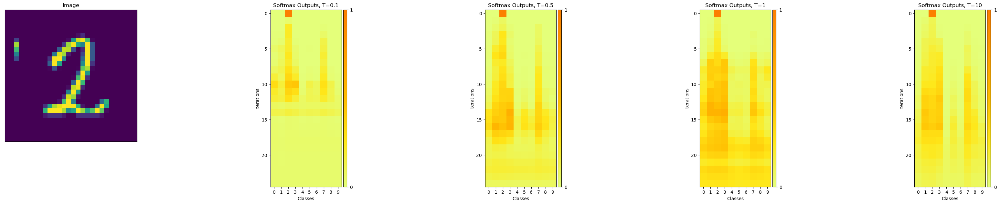

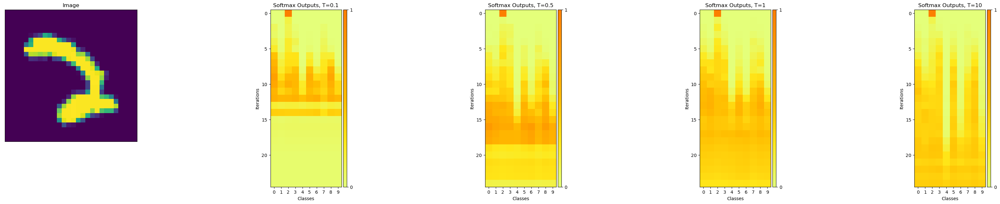

50 least confusing 3s


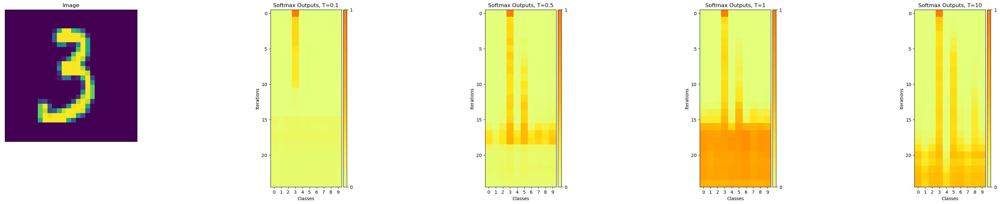

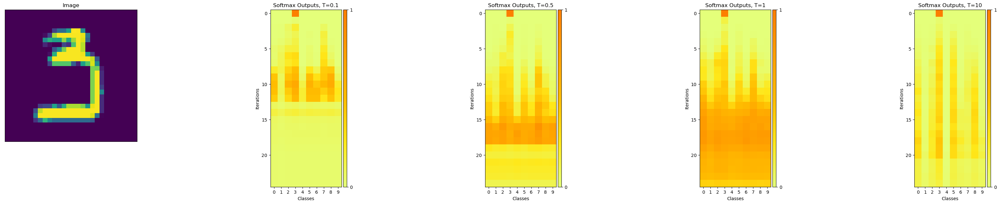

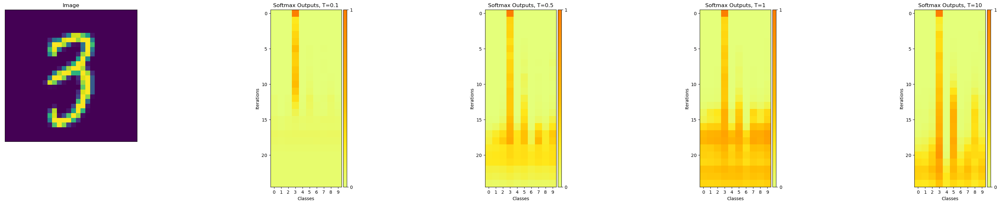

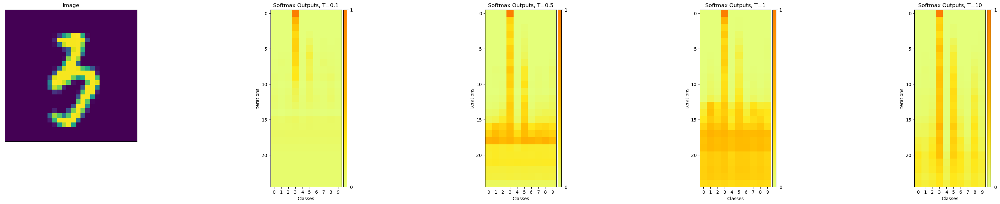

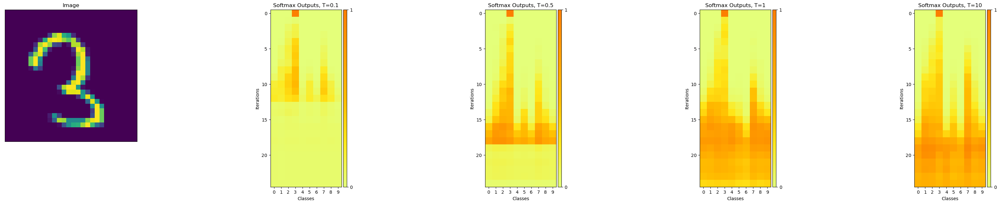

...

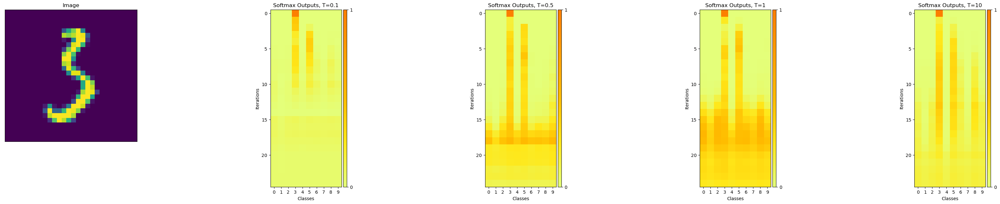

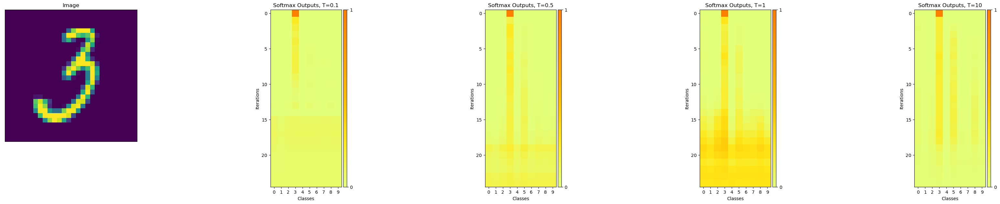

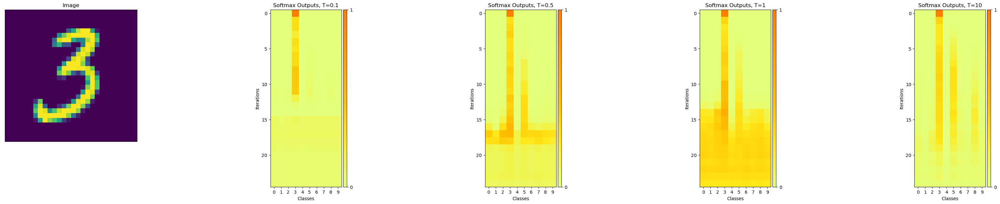

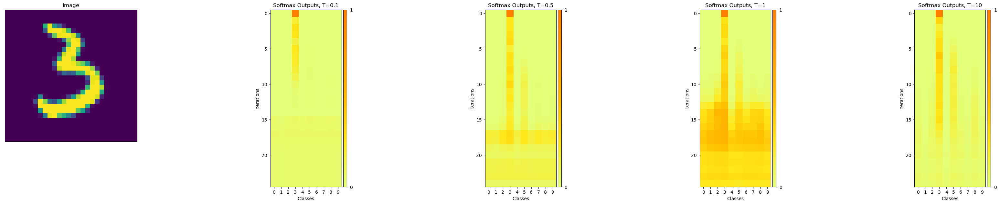

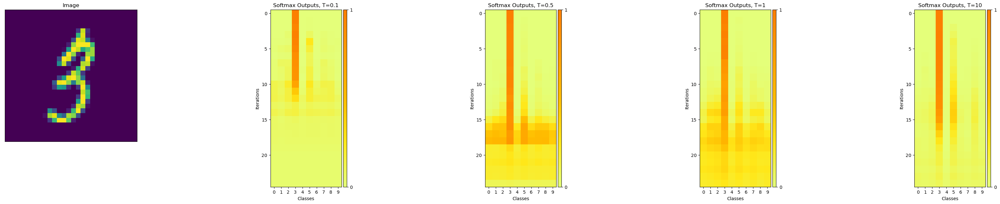

50 least confusing 4s


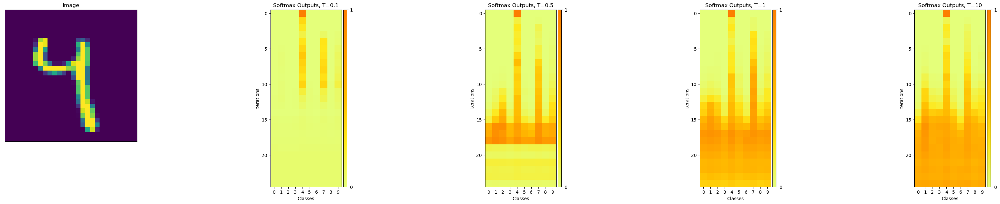

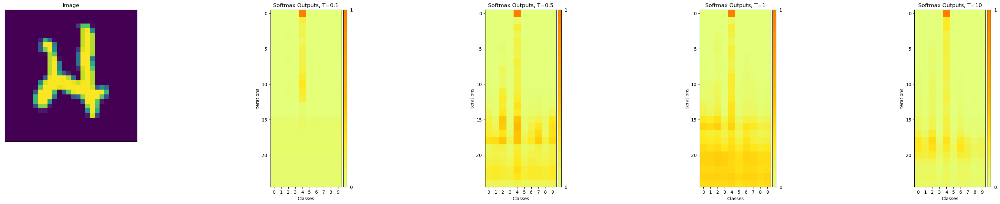

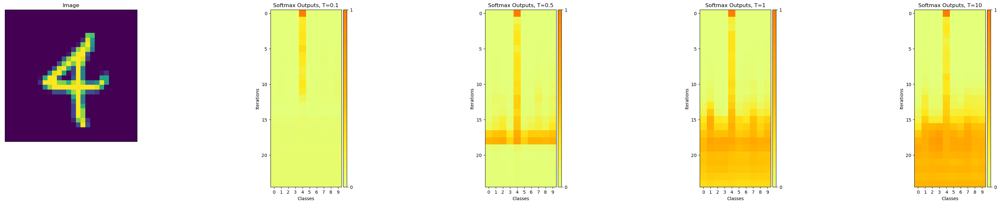

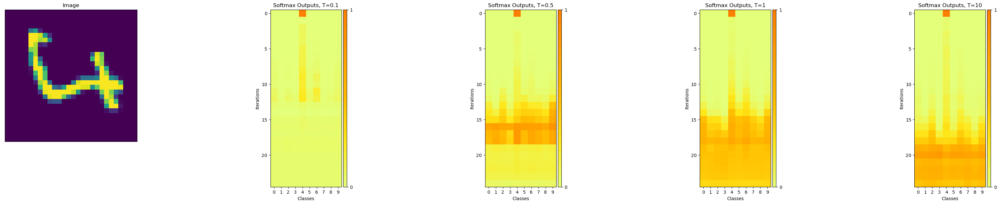

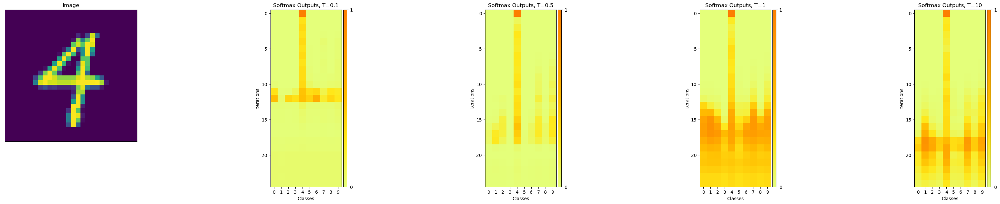

...

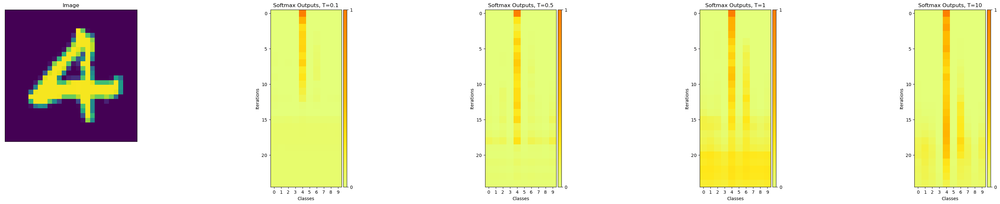

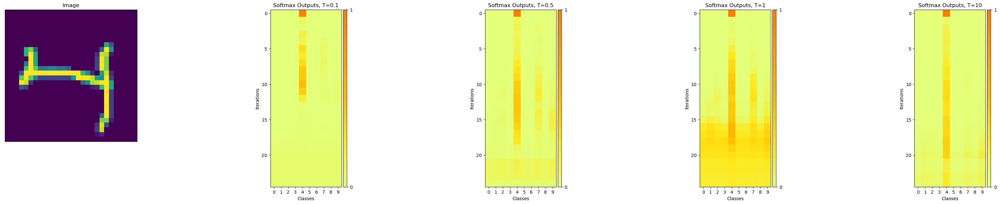

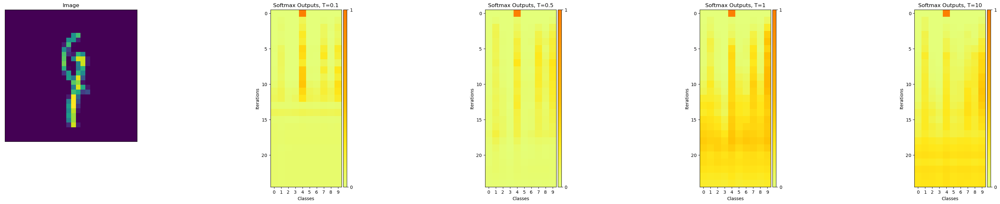

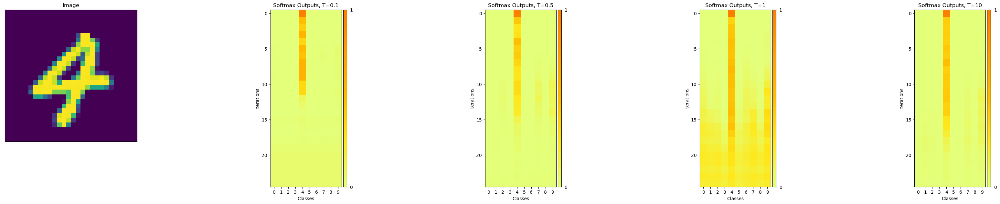

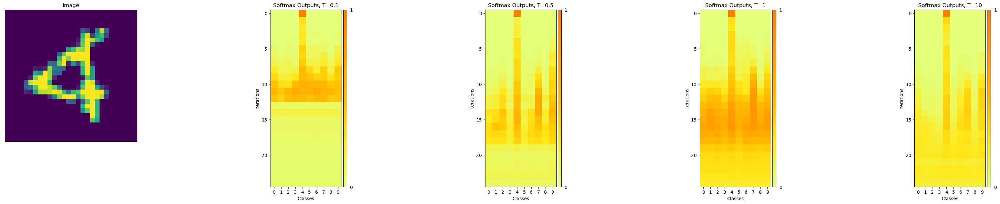

50 least confusing 5s


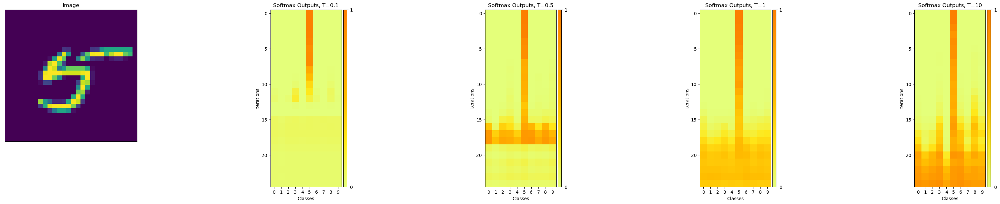

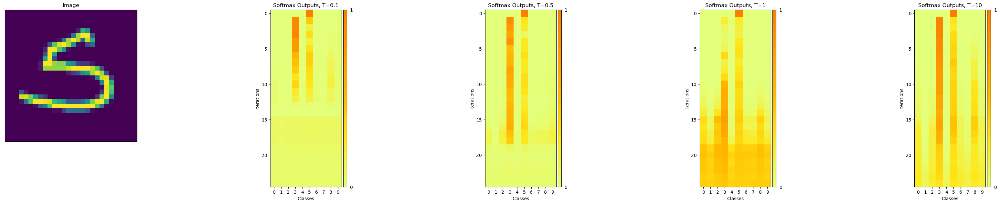

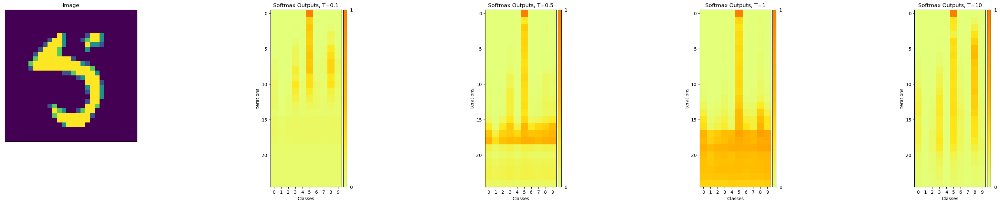

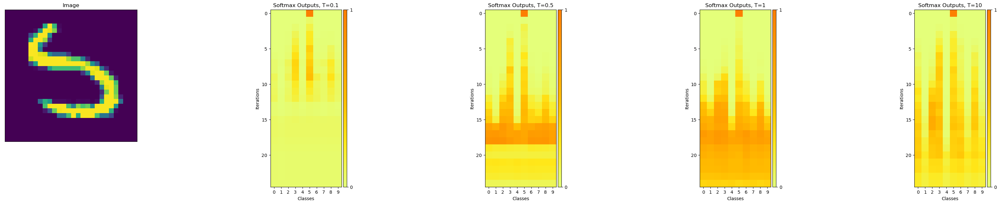

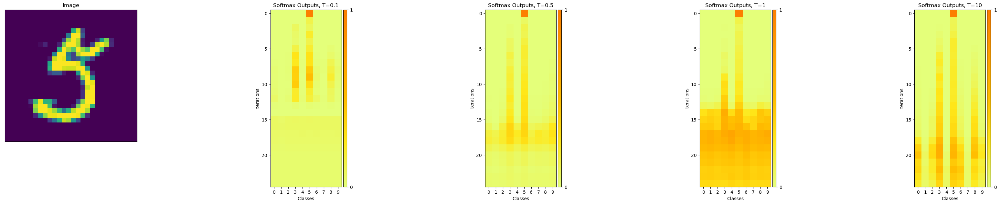

...

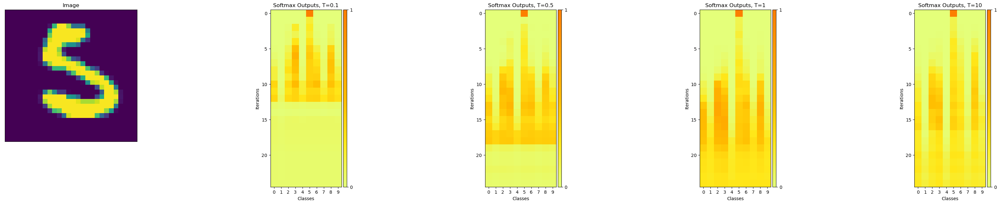

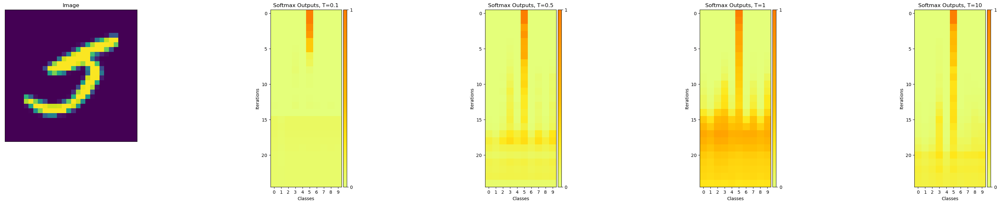

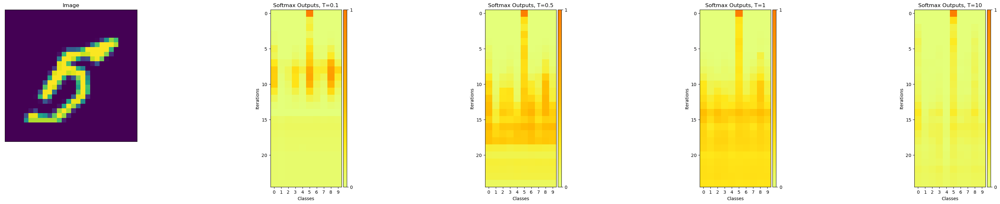

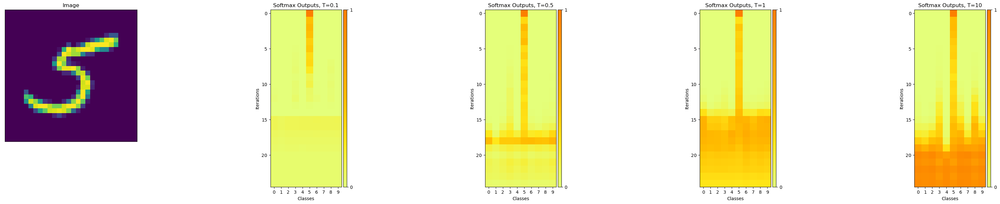

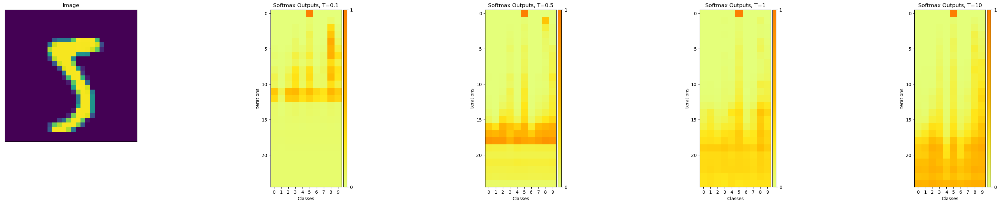

50 least confusing 6s


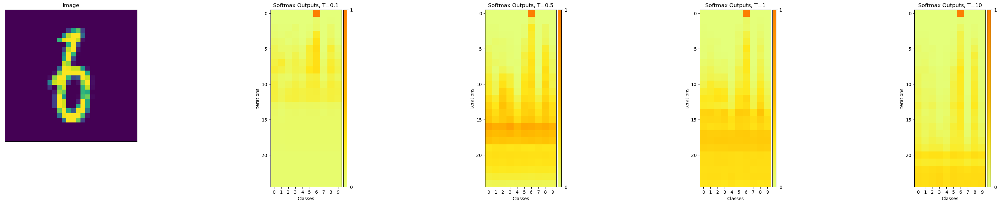

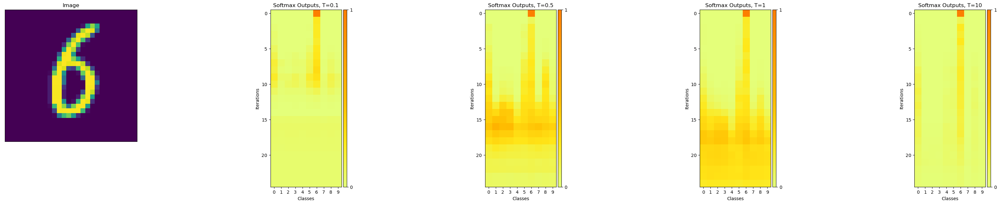

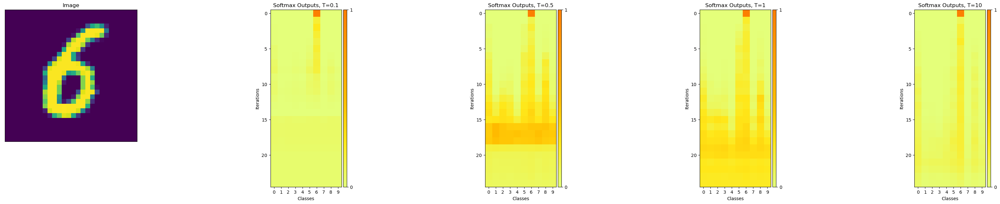

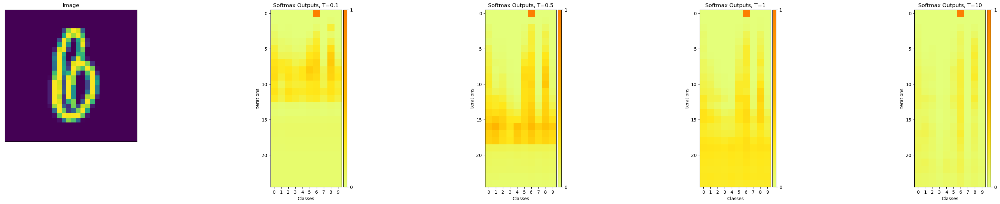

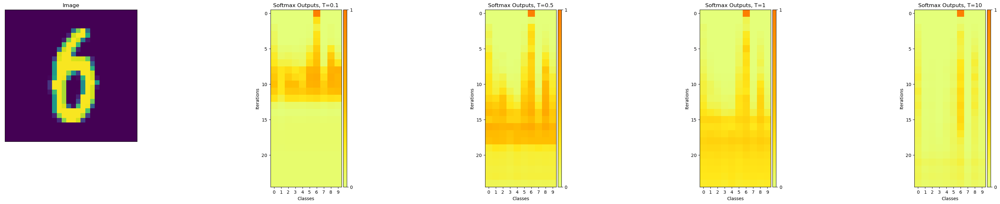

...

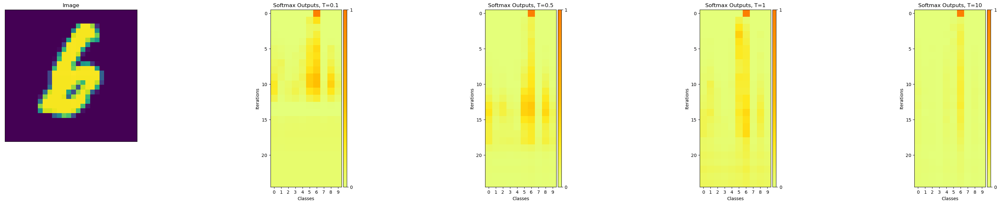

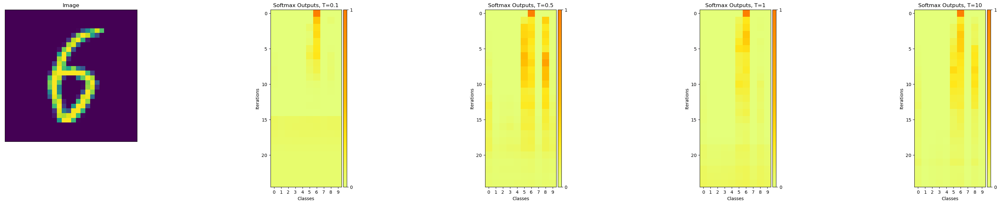

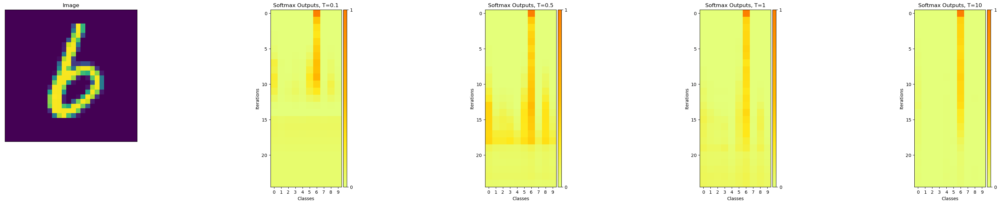

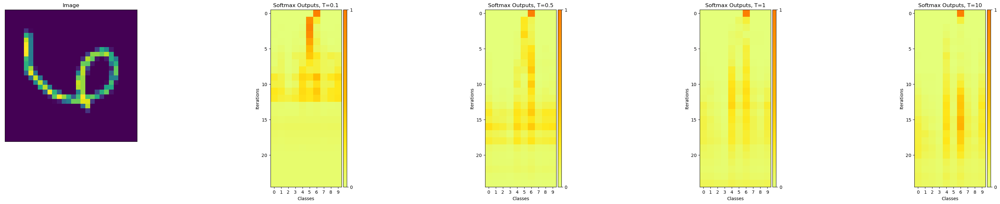

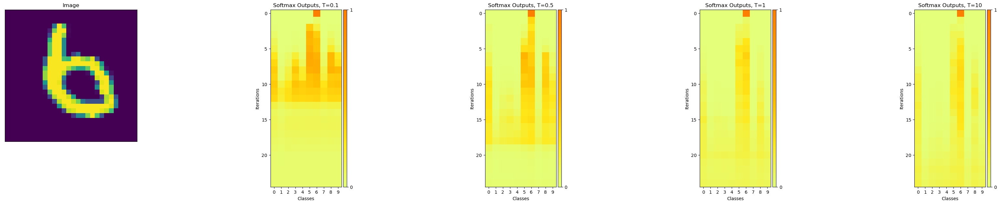

50 least confusing 7s


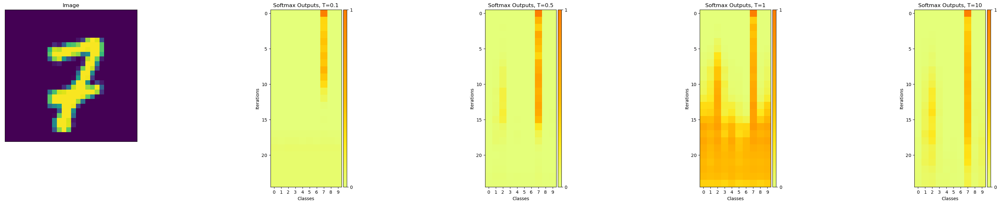

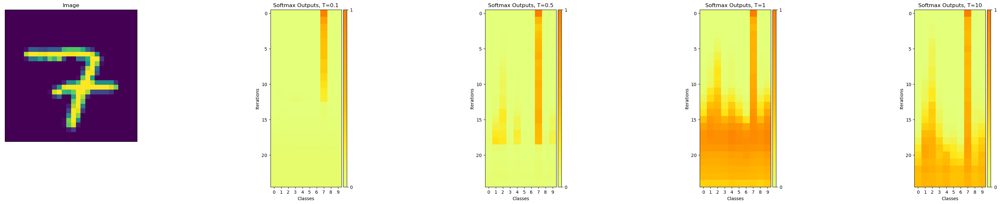

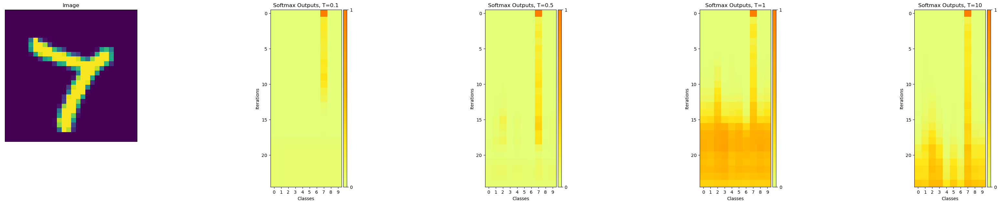

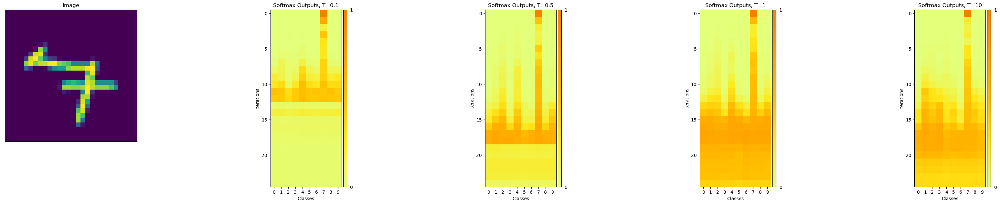

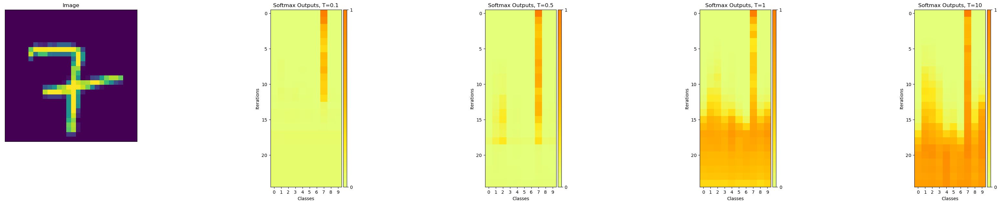

...

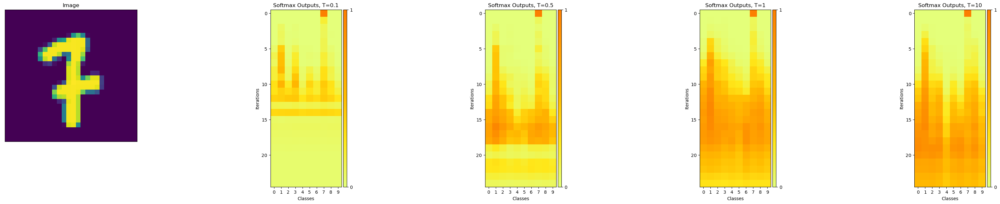

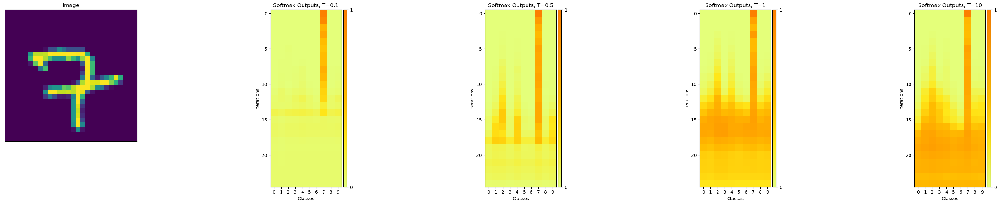

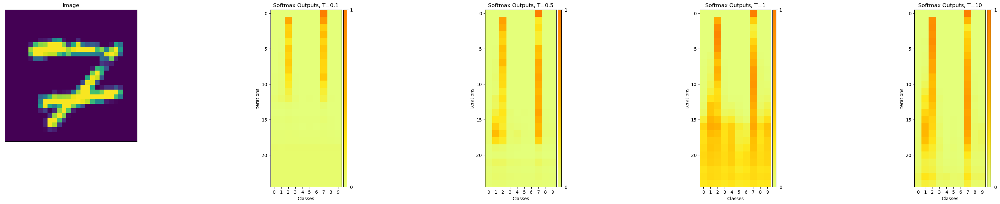

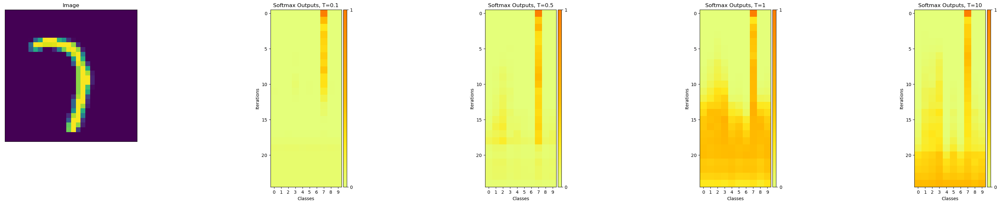

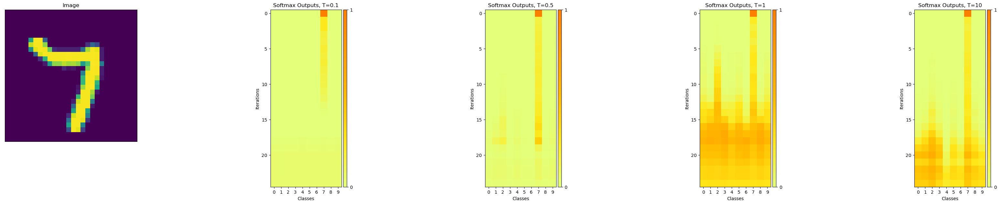

50 least confusing 8s


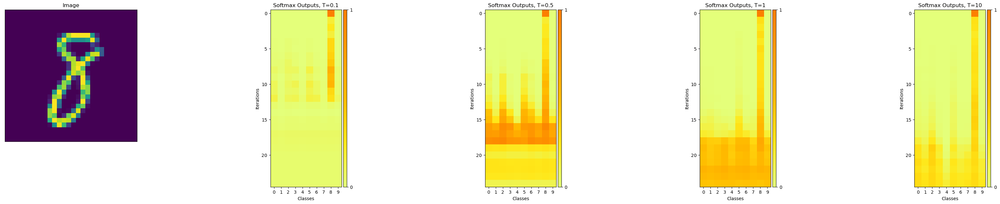

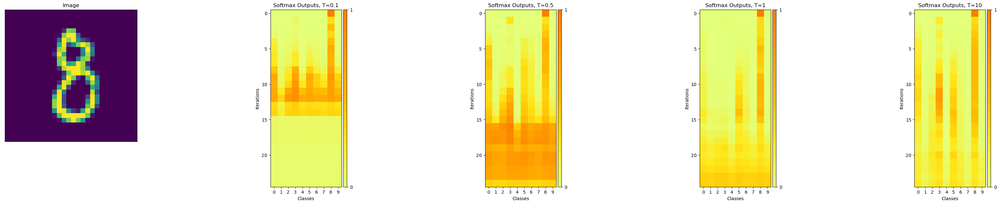

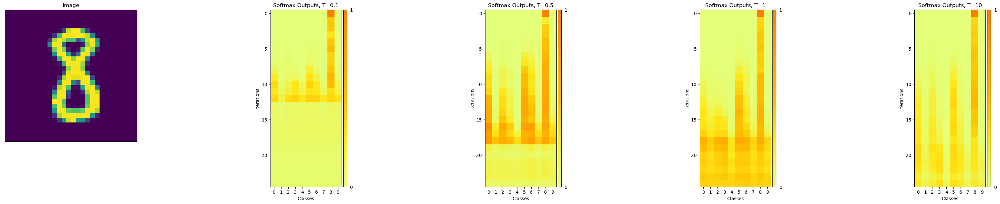

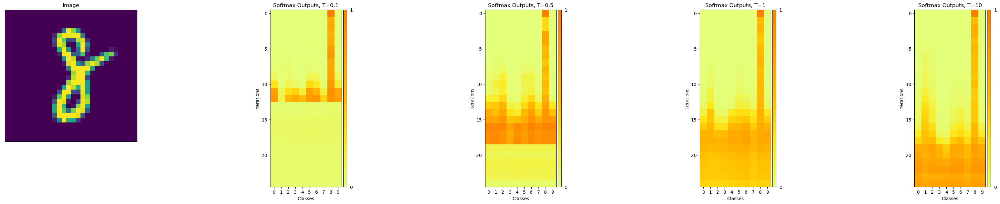

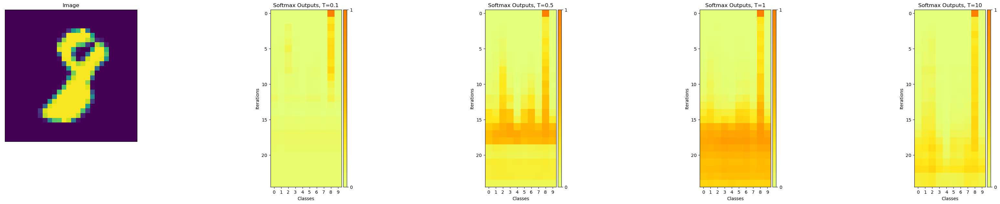

...

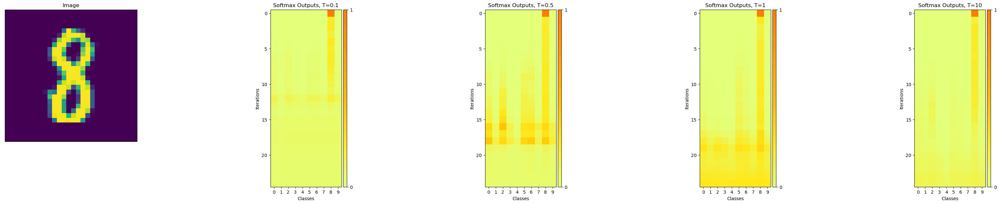

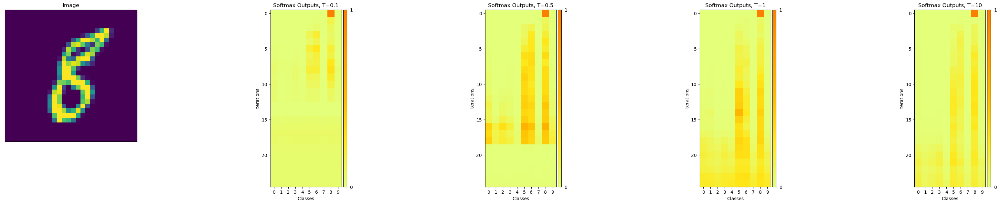

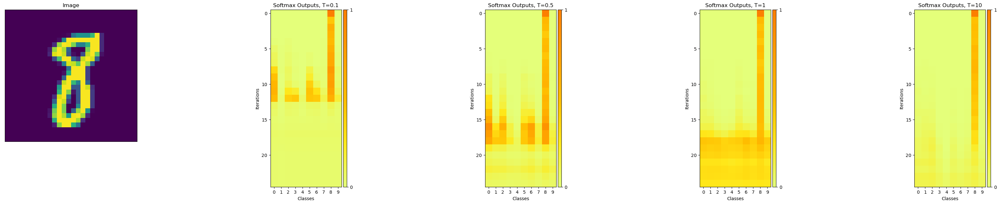

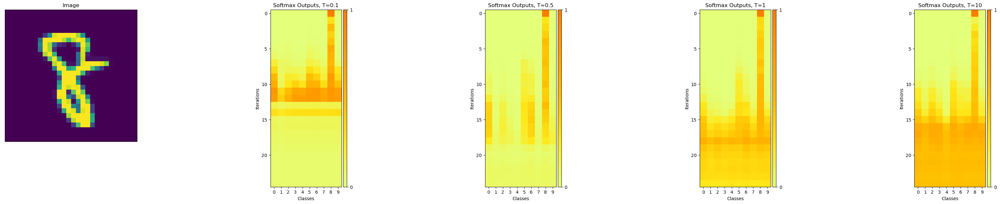

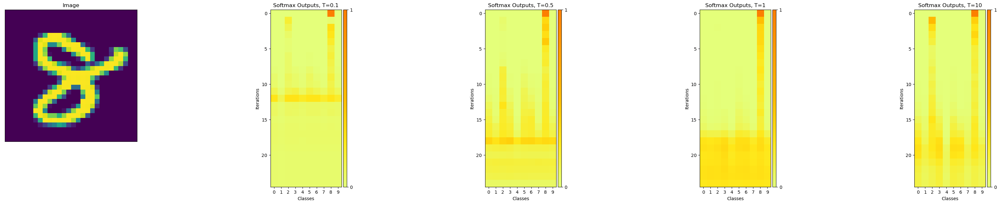

50 least confusing 9s


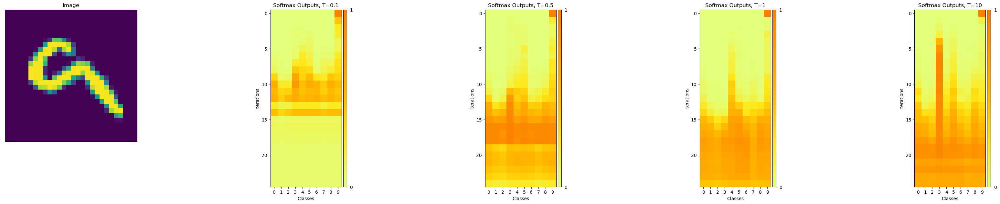

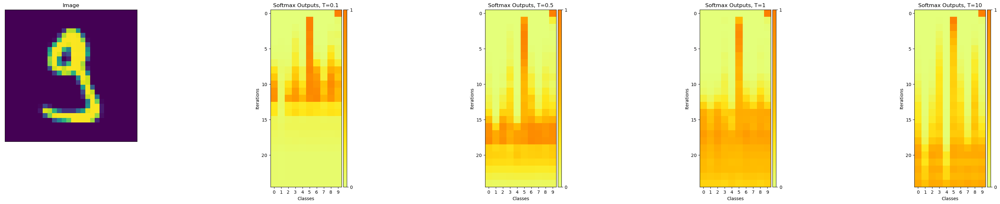

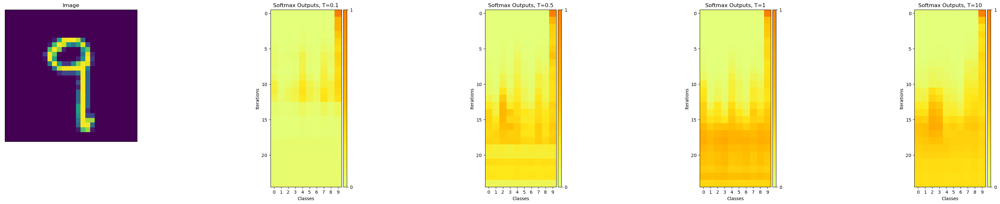

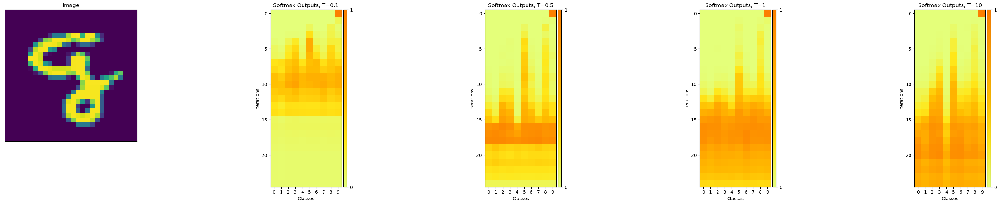

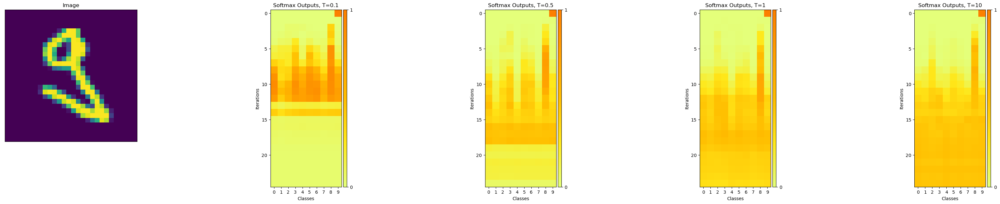

...

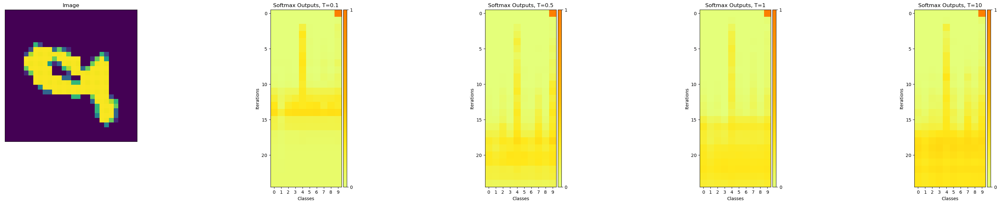

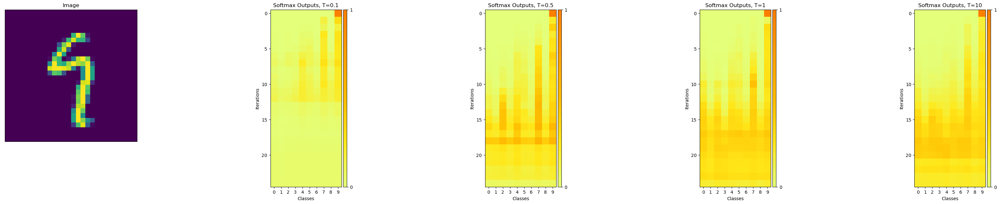

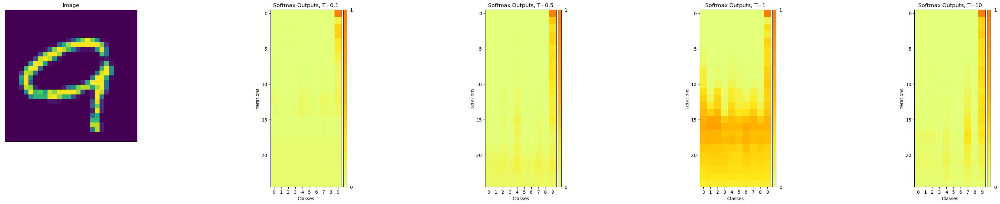

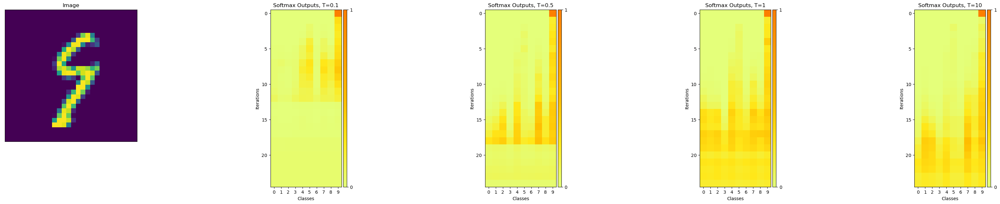

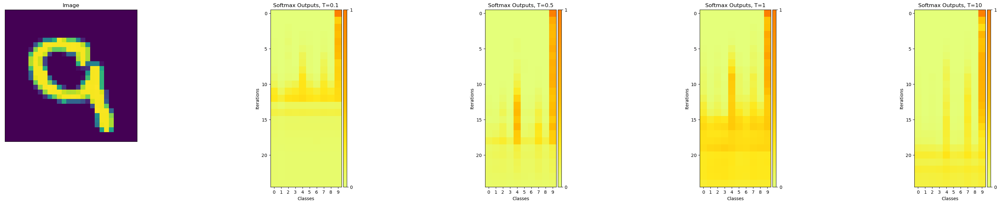

In [45]:
##############################################
## Rank by difference to binary seed vector ##
##############################################
print("Rank method: Binary seed vector difference")

for i in range(10):
    # choose which class to analyze
    CLASS = i

    # determine indices of in-class images
    # note that true_class_tr = true_class_tr_##. all of these should be the same since
    # the indices of the in class images never change. (And I asserted this)
    class_idxs = np.array(np.where(true_class_tr == CLASS)).squeeze()
    
    # each class data array has dimensions N images by L labels by P iterations
    # The rows of 10D vectors store the softmax outputs for each image for each iteration
    # the indices of the images for each class should be consistent across temp changes
    class_data = y_hat_train_arr[class_idxs, :, :].squeeze()
    class_data_01 = y_hat_train_arr_01[class_idxs, :, :].squeeze()
    class_data_05 = y_hat_train_arr_05[class_idxs, :, :].squeeze()
    class_data_10 = y_hat_train_arr_10[class_idxs, :, :].squeeze()

    # calculate differences in weights for each image between true and final iter
    # use the rank produced for the normal case in the visualization
    diff_arr = class_data[:, CLASS, 0] - class_data[:, CLASS, MAX_ITER - 1]
    # the indices in the seed_diff_rank array are class specific, range from 0 to # in class images
    seed_diff_rank = np.argsort(diff_arr)
    
    compare_temps(i, 50, class_data, class_data_01, class_data_05, class_data_10, seed_diff_rank)

In [16]:
print(class_data.shape)

(5454, 10, 25)


In [17]:
print(class_data_01.shape)

(5454, 10, 25)


In [37]:
sums = y_hat_train_arr.sum(axis=1)
print(y_hat_train_arr[0, :, 24])
print(np.sum(y_hat_train_arr[0, :, 24]))
print(np.sum(y_hat_train_arr[0, :, 0]))

[0.17553043 0.17373595 0.17919119 0.18001305 0.17622186 0.17332062
 0.17336974 0.1765632  0.17275071 0.17669721]
1.7573939561843872
1.0


# Scratch work

In [31]:
# load mnist fashion data
import gzip
x_test_bin = gzip.GzipFile("src_data/mnist_fashion/t10k-images-idx3-ubyte.gz")
x_test = np.load(x_test_bin)

ValueError: Cannot load file containing pickled data when allow_pickle=False